# Diffusion models: Sampling and conditional sampling of a pretrained DDPM model

This notebook is based on the [github repository](https://github.com/DPS2022/diffusion-posterior-sampling.git) of

*Diffusion Posterior Sampling for General Noisy Inverse Problems*, <br/>
by Hyungjin Chung, Jeongsol Kim, Michael T. Mccann, Marc L. Klasky, Jong Chul Ye, <br/>
ICLR 2023, https://arxiv.org/abs/2209.14687

We use the U-net trained by the authors on the FFHQ datasets (using 49k images, ```01000.png``` to ```49999.png```).

It is a DDPM model based on

* Diffusion Models Beat GANs on Image Synthesis, Prafulla Dhariwal, Alex Nichol, NeurIPS 2021, https://arxiv.org/abs/2105.05233
[github](https://github.com/openai/guided-diffusion/)

* Denoising Diffusion Probabilistic Models, Jonathan Ho, Ajay Jain, Pieter Abbeel, NeurIPS 2020, https://arxiv.org/abs/2006.11239
[projectpage](https://hojonathanho.github.io/diffusion/)


$\newcommand{\bx}{\mathbf{x}} % bold x$
$\newcommand{\bz}{\mathbf{z}} % bold z$


# Download files:

In [1]:
!git clone https://github.com/DPS2022/diffusion-posterior-sampling.git
!cp -r diffusion-posterior-sampling/guided_diffusion guided_diffusion
!wget -nc -O ffhq256-1k-validation.zip 'https://www.dropbox.com/scl/fi/pppstbdsf0em6o0qscruc/ffhq256-1k-validation.zip?rlkey=xl7nwv2nxb6yvsirr3wad77hm'
!unzip -nq ffhq256-1k-validation.zip
!wget -nc -O ffhq_10m.pt 'https://www.dropbox.com/scl/fi/pq72vxzxcbygieq5z4gvf/ffhq_10m.pt?rlkey=5sxdj6r4o9f7b7bbp5fxg2f5r'

Cloning into 'diffusion-posterior-sampling'...
remote: Enumerating objects: 82, done.
remote: Total 82 (delta 0), reused 0 (delta 0), pack-reused 82 (from 1)
Receiving objects: 100% (82/82), 16.19 MiB | 17.07 MiB/s, done.
Resolving deltas: 100% (30/30), done.
--2025-03-20 08:30:42--  https://www.dropbox.com/scl/fi/pppstbdsf0em6o0qscruc/ffhq256-1k-validation.zip?rlkey=xl7nwv2nxb6yvsirr3wad77hm
Resolving www.dropbox.com (www.dropbox.com)... 162.125.81.18, 2620:100:6035:18::a27d:5512
Connecting to www.dropbox.com (www.dropbox.com)|162.125.81.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://ucea8e6137feb99a7cd69b22882a.dl.dropboxusercontent.com/cd/0/inline/CmM-VWyjv6QJKadStJbnfv7bOFgPBVpuqukgzjKJM_3rnnKg4MJXYq2bWoEvpAuCz3TvVjT-soX7-NF08ckpMt1njky2cEMLrHxoeeX34QSquVgq8iSqop68-9opixgbxdE/file# [following]
--2025-03-20 08:30:43--  https://ucea8e6137feb99a7cd69b22882a.dl.dropboxusercontent.com/cd/0/inline/CmM-VWyjv6QJKadStJbnfv7bOFgPBVpuqukgzjKJM_3rnnKg

In [2]:
import torch
import torchvision
import numpy as np

import matplotlib.pyplot as plt

from PIL import Image
from tqdm import tqdm
from guided_diffusion.unet import create_model
device = "cuda:0" if torch.cuda.is_available() else "cpu"
print("Device:", device)

Device: cuda:0


# Display functions
We will work with PyTorch images with color values in $[-1,1]$ and the usual additional batch dimension.
Images will have size 1x3x256x256 in PyTorch.

In [3]:
def pilimg_to_tensor(pil_img):
  t = torchvision.transforms.ToTensor()(pil_img)
  t = 2*t-1 # [0,1]->[-1,1]
  t = t.unsqueeze(0)
  t = t.to(device)
  return(t)

def display_as_pilimg(t):
  t = 0.5+0.5*t.to('cpu')
  t = t.squeeze()
  t = t.clamp(0.,1.)
  pil_img = torchvision.transforms.ToPILImage()(t)
  display(pil_img)
  return(pil_img)

idx = np.random.randint(1000)
print('Image', str(idx).zfill(5))
img_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')



Image 00649


# Load DDPM Unet

In [5]:
# Load model
model_config = {'image_size': 256,
                'num_channels': 128,
                'num_res_blocks': 1,
                'channel_mult': '',
                'learn_sigma': True,
                'class_cond': False,
                'use_checkpoint': False,
                'attention_resolutions': 16,
                'num_heads': 4,
                'num_head_channels': 64,
                'num_heads_upsample': -1,
                'use_scale_shift_norm': True,
                'dropout': 0.0,
                'resblock_updown': True,
                'use_fp16': False,
                'use_new_attention_order': False,
                'model_path': 'ffhq_10m.pt'}
model = create_model(**model_config)
model = model.to(device)
# use in eval mode:
model.eval();

# DDPM class

The DDPM class defined below will be used to sample the DDPM model.

The Unet ```model``` estimates the residual noise $\varepsilon_t(x_t, t)$ from a noisy image $(x_t, t)$.

The method ```get_eps_from_model(self, x, t)``` computes $\varepsilon_t(x_t, t)$.

The method ```predict_xstart_from_eps(self, x, eps, t)``` computes

$$
\hat{x}_0(x_t) = \frac{1}{\sqrt{\bar{\alpha}_t}} x_t
- \sqrt{\frac{1}{\bar{\alpha}_t}-1} \;  \varepsilon_t(x_t, t).
$$

In the following exercises, you will have to complete methods `sample` and `posterior_sampling` defined in this class.

Remark that several variables are already precomputed in the class:
* `self.num_diffusion_timesteps` : $T$
* `self.reversed_time_steps` : backward $t$ range:  $\{T, T-1, \ldots, 1\}$
* `self.betas` : $(\beta_t)_{1 \leq t \leq T}$
* `self.alphas` : $(\alpha_t)_{1 \leq t \leq T}$
* `self.alphas_cumprod` : $(\bar{\alpha}_t)_{1 \leq t \leq T}$
* `self.alphas_cumprod_prev` : $(\bar{\alpha}_{t-1})_{1 \leq t \leq T}$


In [6]:
sigma_noise = 2*10/255

class DDPM:
  def __init__(self, model=model):
    self.num_diffusion_timesteps = 1000
    self.reversed_time_steps = np.arange(self.num_diffusion_timesteps)[::-1]
    beta_start = 0.0001
    beta_end = 0.02
    self.betas = np.linspace(beta_start, beta_end, self.num_diffusion_timesteps,
                              dtype=np.float64)
    self.alphas = 1.0 - self.betas
    self.alphas_cumprod = np.cumprod(self.alphas, axis=0)
    self.alphas_cumprod_prev = np.append(1.0, self.alphas_cumprod[:-1])
    self.model = model
    self.imgshape = (1,3,256,256)

  def get_eps_from_model(self, x, t):
    # the model outputs:
    # - an estimation of the noise eps (chanels 0 to 2)
    # - learnt variances for the posterior  (chanels 3 to 5)
    # (see Improved Denoising Diffusion Probabilistic Models
    # by Alex Nichol, Prafulla Dhariwal
    # for the parameterization)
    # We discard the second part of the output for this practice session.
    model_output = self.model(x, torch.tensor(t, device=device).unsqueeze(0))
    model_output = model_output[:,:3,:,:]
    return(model_output)

  def predict_xstart_from_eps(self, x, eps, t):
    x_start = (
        np.sqrt(1.0 / self.alphas_cumprod[t])* x
        - np.sqrt(1.0 / self.alphas_cumprod[t] - 1) * eps
    )
    x_start = x_start.clamp(-1.,1.)
    return(x_start)

  def sample(self, x,show_steps=True):
    with torch.no_grad():  # avoid backprop wrt model parameters
      x = torch.randn(self.imgshape,device=device)  # initialize x_t for t=T i.e after adding noise
      print(self.imgshape)
      for i, t in enumerate(self.reversed_time_steps):
        eps = self.get_eps_from_model(x,t)
        #direct computation from  eps
        posterior_mean = 1/np.sqrt(self.alphas[t])*(x - self.betas[t]/np.sqrt(1 - self.alphas_cumprod[t])*eps)
        #compute x_start (only used for visualisation)
        x_start = self.predict_xstart_from_eps(x,eps,t)

        #sample p_theta(t-1|t)
        noise = torch.randn_like(x)
        x = posterior_mean + np.sqrt(self.betas[t])*noise
        if show_steps:
          if i%100==99 or t==10 or i==0:
            print('Iteration : ', i, 't=', t)
            pilimg = display_as_pilimg(torch.cat((x,x_start), dim = 3))
            pilimg.save('ddpm_sample_iter_'+str(i).zfill(4)+'.png')
    return(x)

  def posterior_sampling(self, linear_operator, y, x_true=None, show_steps=True, vis_y=None):

    # visualization image for the observation y:
    if vis_y==None:
      vis_y = y

    # initialize xt for t=T
    x = torch.randn(self.imgshape,device=device)
    x.requires_grad = True

    for i,t in enumerate(self.reversed_time_steps):
      #estimating the noise
      eps = self.get_eps_from_model(x,t)

      #compute x_start
      x_start = self.predict_xstart_from_eps(x,eps,t)

      # compute l2 error:
      l2_error = torch.sum((y - linear_operator(x_start))**2)
      zeta = torch.clamp(1/torch.sqrt(l2_error + 1e-6), min=0, max=1)
      gradx_l2_error = torch.autograd.grad(outputs=l2_error, inputs=x)[0]

      #direct computation from eps
      noise = torch.randn_like(x)
      posterior_mean = 1/np.sqrt(self.alphas[t])*(x - self.betas[t]/np.sqrt(1 - self.alphas_cumprod[t])*eps)

      #sample p_theta(t-1|t)
      #noise = torch.randn_like(x)
      x = posterior_mean + np.sqrt(self.betas[t])*noise

      #posterior sampling correction
      x -= .1*zeta*gradx_l2_error

      if show_steps:
        if i%100==99 or t==10 or i==0:
          print('Iteration :', i, 't=', t)
          pilimg = display_as_pilimg(torch.cat((x,x_start), dim = 3))
          pilimg.save('ddpm_posterior_sample_iter_'+str(i).zfill(4)+'.png')
    return(x)

ddpm = DDPM()

<br/><br/><br/>

📸 İşleniyor: ffhq256-1k-validation/00001.png
Iteration 100 for image 1


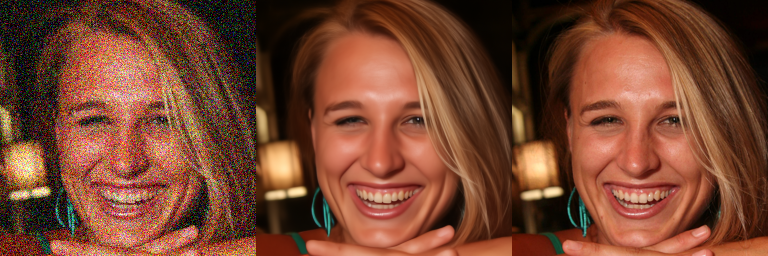

Iteration 200 for image 1


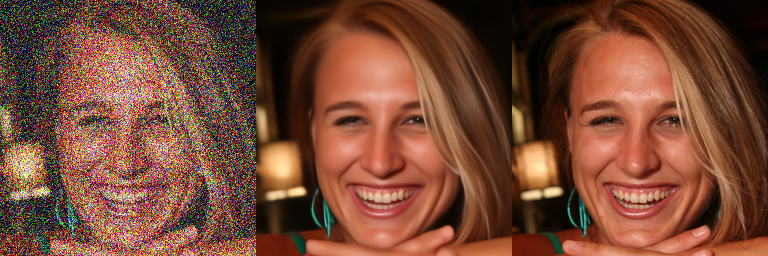

Iteration 300 for image 1


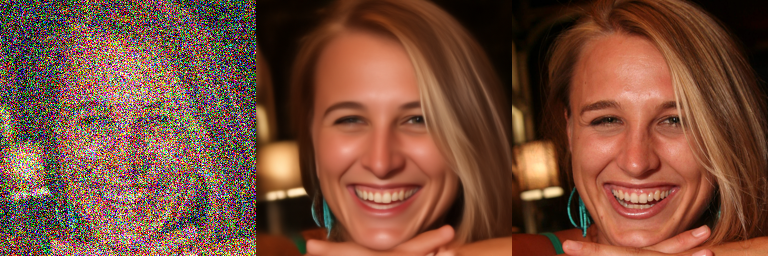

Iteration 400 for image 1


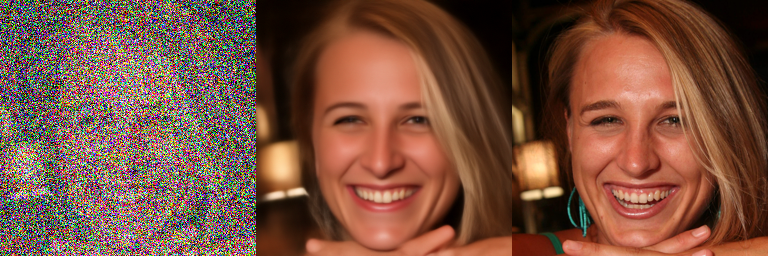

Iteration 500 for image 1


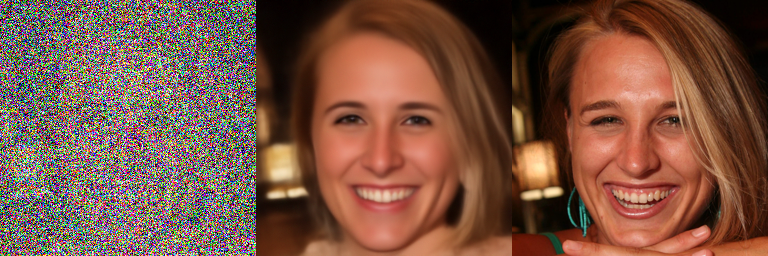

Iteration 600 for image 1


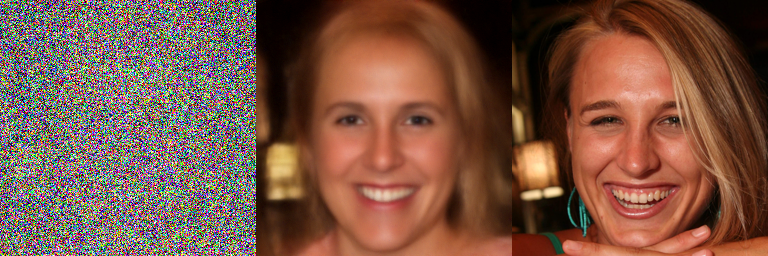

Iteration 700 for image 1


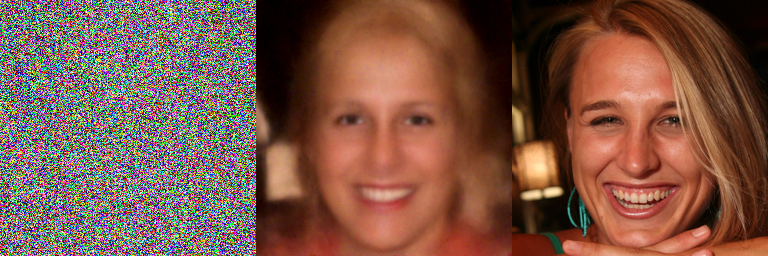

Iteration 800 for image 1


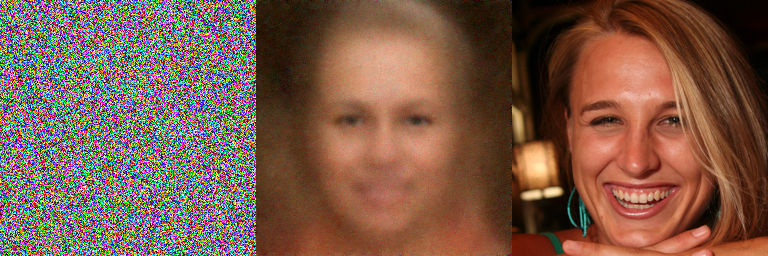

Iteration 900 for image 1


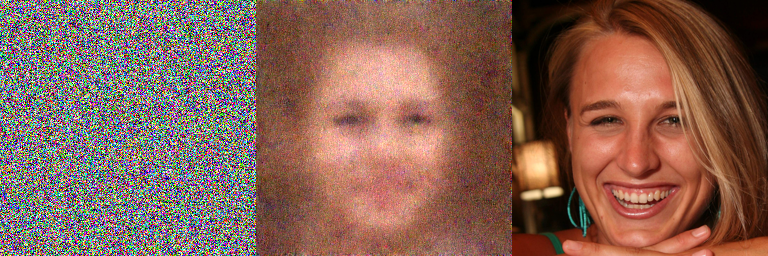

Iteration 1000 for image 1


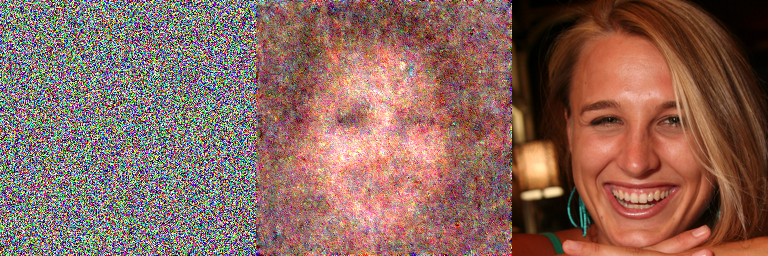

✅ Tüm seçilen görüntüler işlendi!


In [7]:
import torch
import os
import numpy as np
from PIL import Image

# Kullanılacak belirli görüntü indeksleri
selected_indices = [1]  # İşlenmesini istediğin indeksler

# Veri setinin bulunduğu klasör
image_folder = "ffhq256-1k-validation/"

# PSNR değerlerini kaydetmek için boş listeler
psnr_noisy_all = []
psnr_denoised_all = []

def mypsnr(x, y):
    error = torch.mean((x - y) ** 2).item()
    psnr = 10 * np.log10(2 ** 2 / error)
    return psnr

for idx in selected_indices:
    img_path = os.path.join(image_folder, str(idx).zfill(5) + ".png")

    if not os.path.exists(img_path):
        print(f"⚠ Warning: {img_path} bulunamadı! Dosya listesini kontrol et.")
        continue  # Eğer dosya yoksa atla

    print(f"📸 İşleniyor: {img_path}")  # Hangi dosyanın işlendiğini terminale yazdır

    img_pil = Image.open(img_path)
    x0 = pilimg_to_tensor(img_pil).to(device)  # Görüntüyü tensöre çevir ve GPU/CPU'ya gönder

    psnr_noisy = []
    psnr_denoised = []

    xt = x0.clone()  # Initialize xt for t=0
    for t in range(ddpm.num_diffusion_timesteps):

        with torch.no_grad():  # Avoid backprop wrt model parameters
            z = torch.randn(x0.size()).to(device)
            xt = np.sqrt(ddpm.alphas[t]) * xt + np.sqrt(ddpm.betas[t]) * z

            eps = ddpm.get_eps_from_model(xt, t)
            xhat = ddpm.predict_xstart_from_eps(xt, eps, t)

            psnr_noisy.append(mypsnr(xt, x0))
            psnr_denoised.append(mypsnr(xhat, x0))

            if (t + 1) % 100 == 0:
                print(f"Iteration {t + 1} for image {idx}")
                pilimg = display_as_pilimg(torch.cat((xt, xhat, x0), dim=3))

    # Sonuçları listeye ekleyelim
    psnr_noisy_all.append(psnr_noisy)
    psnr_denoised_all.append(psnr_denoised)

print("✅ Tüm seçilen görüntüler işlendi!")


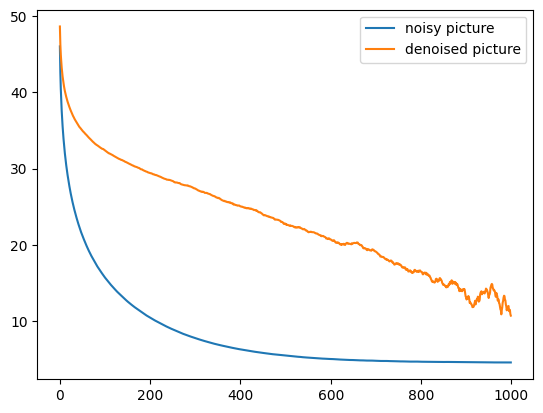

In [8]:
# TODO Q2 plot
plt.plot(psnr_noisy, label = 'noisy picture')
plt.plot(psnr_denoised, label = 'denoised picture')
plt.legend()

<br/><br/><br/>

<br/><br/><br/>

cuda:0
original image 00001.png


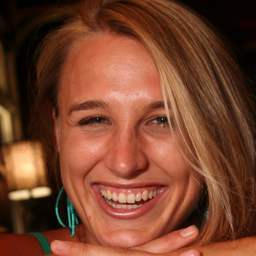

noisy measurement


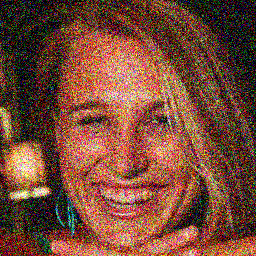

In [11]:
h = 256
w = 256
hcrop, wcrop = h//2, w//2
corner_top, corner_left = h//4, int(0.45*w)
mask = torch.ones(ddpm.imgshape, device=device)
mask[:,:,corner_top:corner_top+hcrop,corner_left:corner_left+wcrop] = 0

def linear_operator(x):
  return x

idx = 1
x_true_pil = Image.open('ffhq256-1k-validation/'+str(idx).zfill(5)+'.png')
x_true = pilimg_to_tensor(x_true_pil)
print(x_true.device)
print("original image", str(idx).zfill(5)+'.png')
display_as_pilimg(x_true)

sigma_noise = 2*60/255

y = linear_operator(x_true.clone()) + sigma_noise *  torch.randn_like(x_true)
print("noisy measurement")
display_as_pilimg(y);

Iteration : 0 t= 999


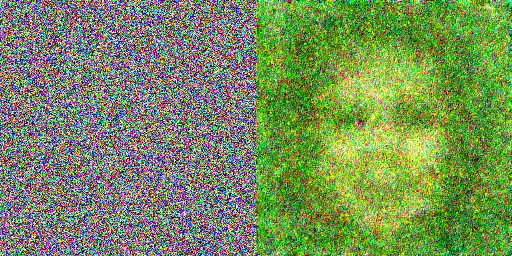

Iteration : 99 t= 900


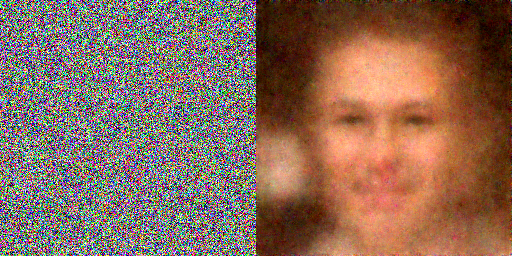

Iteration : 199 t= 800


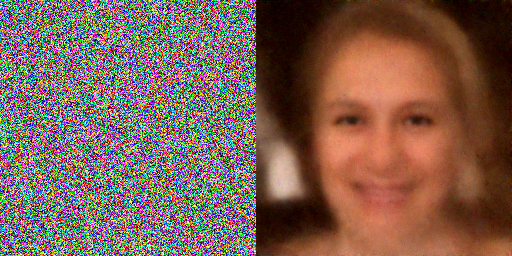

Iteration : 299 t= 700


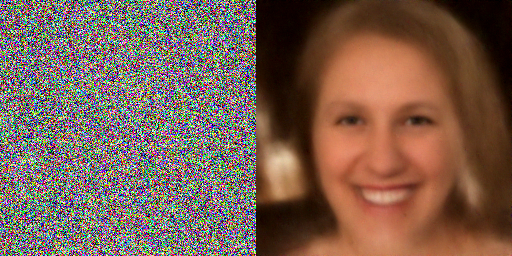

Iteration : 399 t= 600


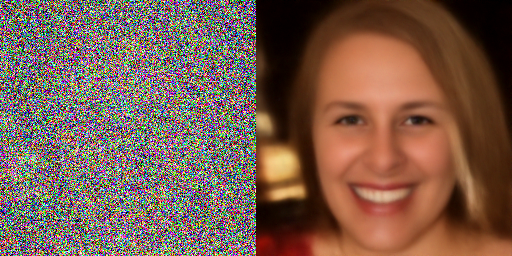

Iteration : 499 t= 500


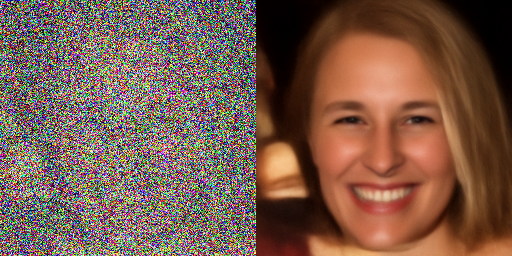

Iteration : 599 t= 400


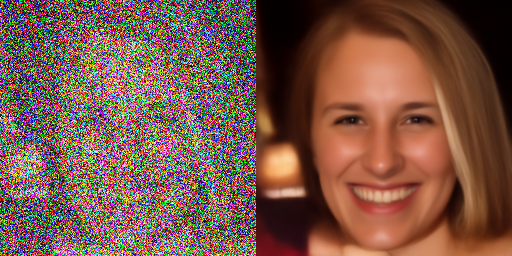

Iteration : 699 t= 300


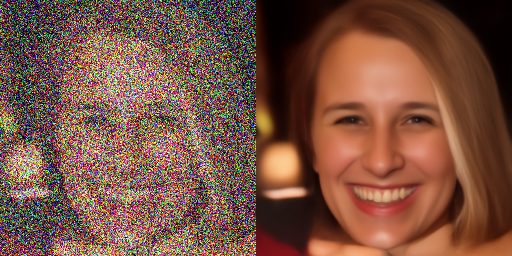

Iteration : 799 t= 200


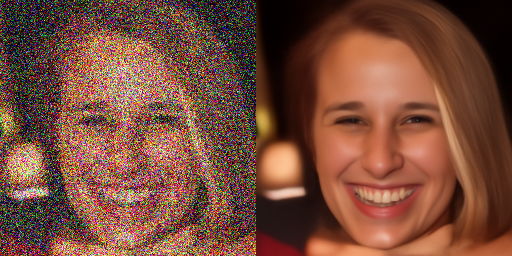

Iteration : 899 t= 100


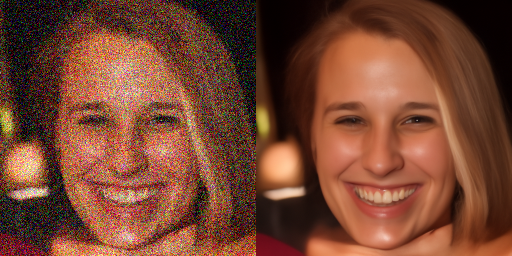

Iteration : 989 t= 10


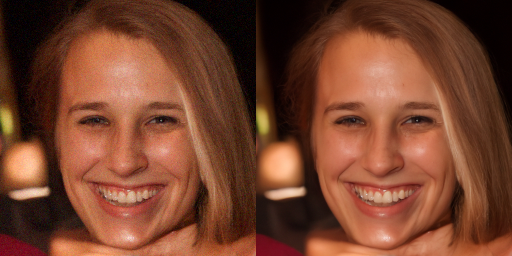

Iteration : 999 t= 0


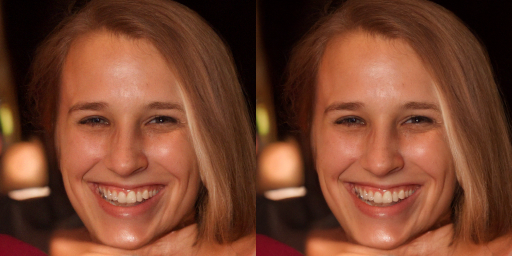

Iteration : 0 t= 999


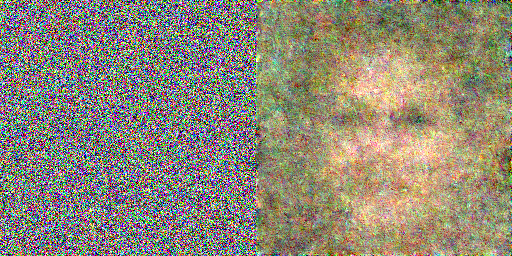

Iteration : 99 t= 900


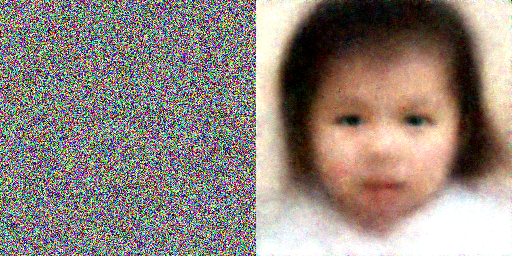

Iteration : 199 t= 800


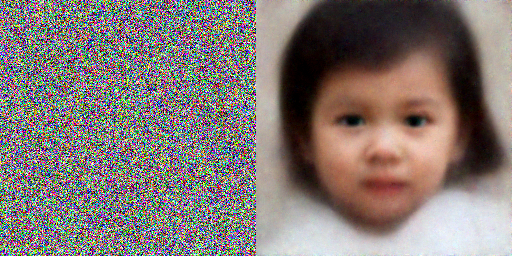

Iteration : 299 t= 700


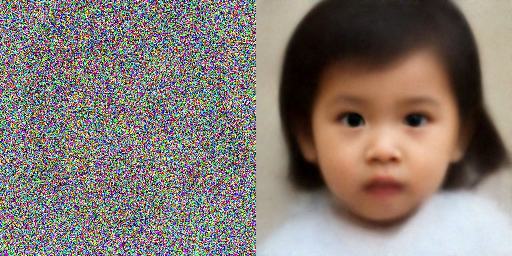

Iteration : 399 t= 600


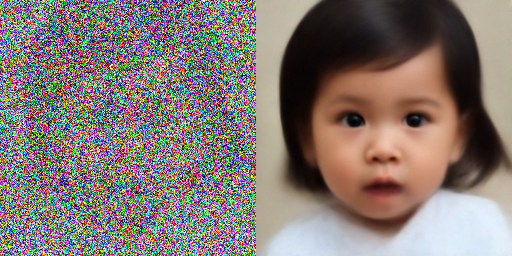

Iteration : 499 t= 500


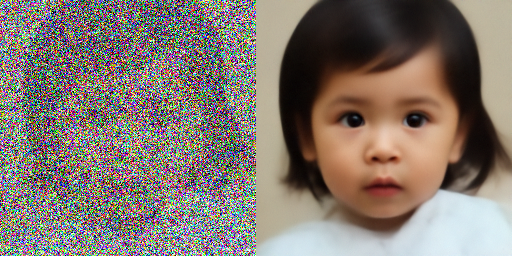

Iteration : 599 t= 400


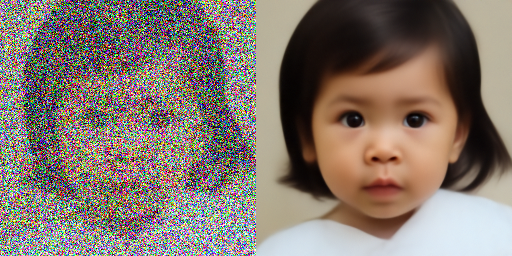

Iteration : 699 t= 300


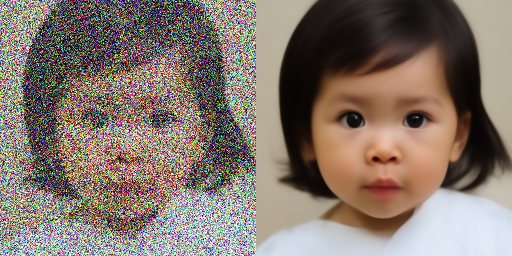

Iteration : 799 t= 200


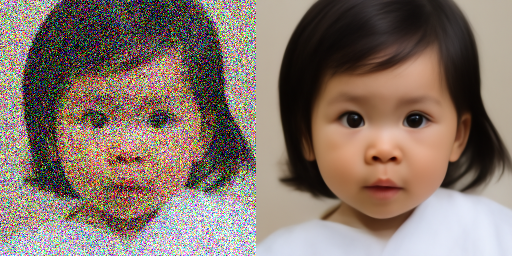

Iteration : 899 t= 100


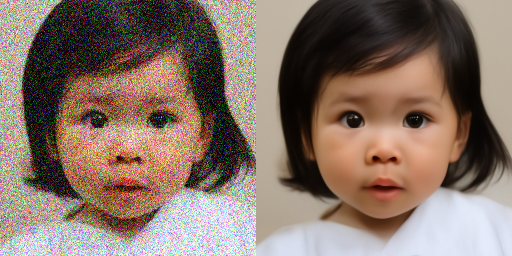

Iteration : 989 t= 10


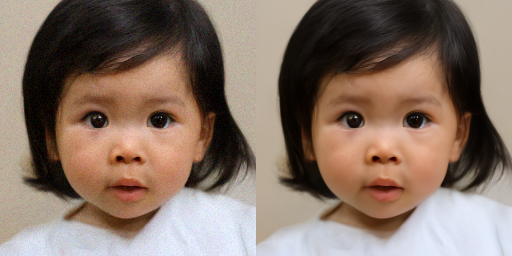

Iteration : 999 t= 0


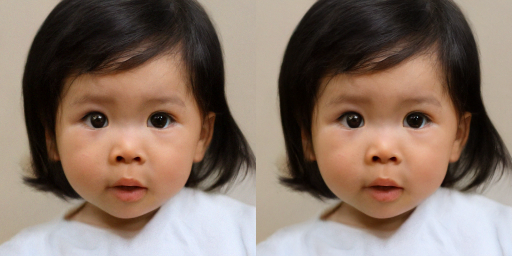

Iteration : 0 t= 999


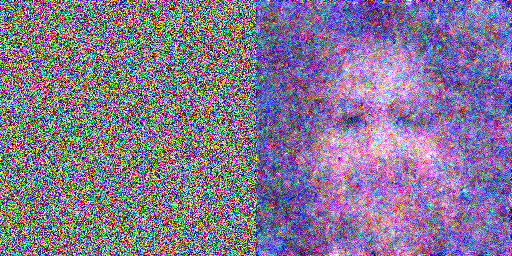

Iteration : 99 t= 900


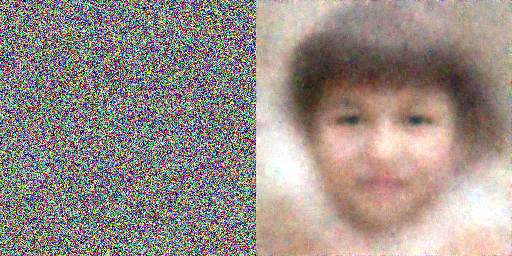

Iteration : 199 t= 800


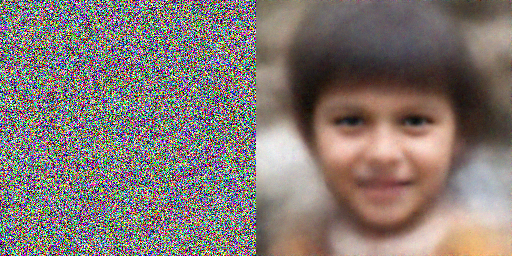

Iteration : 299 t= 700


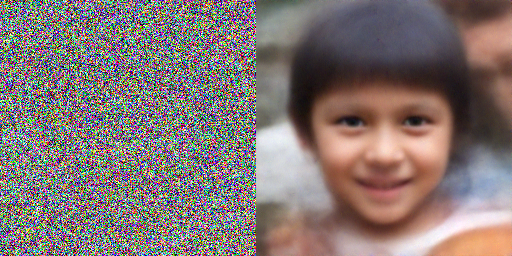

Iteration : 399 t= 600


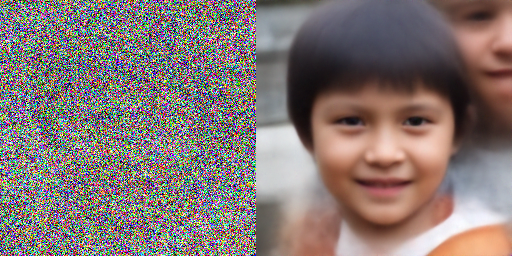

Iteration : 499 t= 500


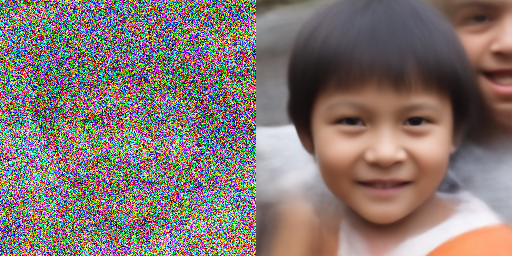

Iteration : 599 t= 400


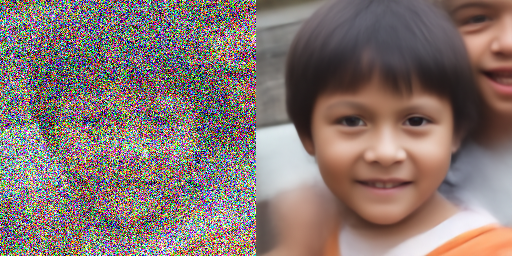

Iteration : 699 t= 300


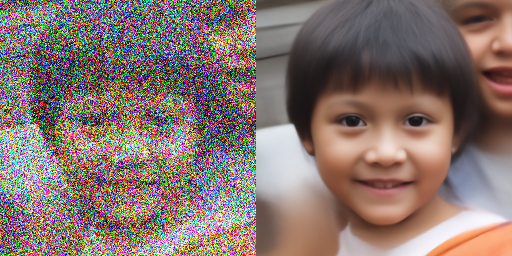

Iteration : 799 t= 200


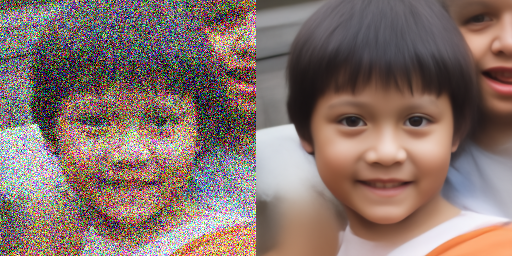

Iteration : 899 t= 100


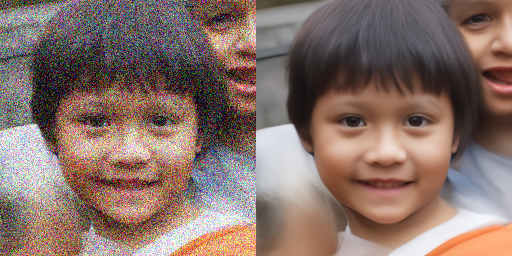

Iteration : 989 t= 10


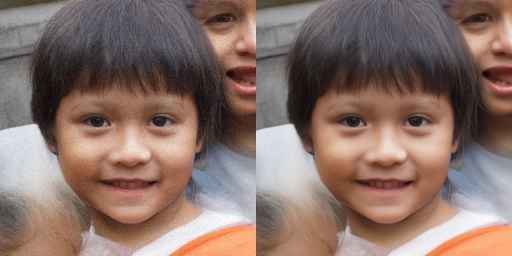

Iteration : 999 t= 0


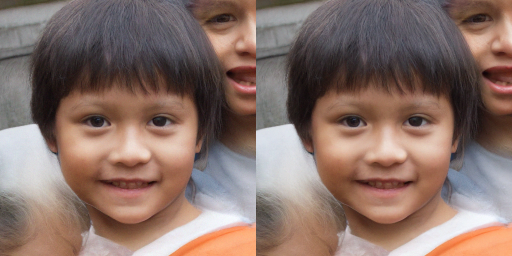


📊 **FID Sonuçları** 📊
╒════╤════════════╤═══════════════════════╤═════════════════════════════════╤══════════════════════════════════╕
│    │   Image ID │   FID (Noisy vs True) │   FID (Reconstructed X vs True) │   FID (Noisy vs Reconstructed X) │
╞════╪════════════╪═══════════════════════╪═════════════════════════════════╪══════════════════════════════════╡
│  0 │          1 │               3376.08 │                         40.6231 │                          3720.8  │
├────┼────────────┼───────────────────────┼─────────────────────────────────┼──────────────────────────────────┤
│  1 │          3 │               3041.37 │                         11.3231 │                          3152.93 │
├────┼────────────┼───────────────────────┼─────────────────────────────────┼──────────────────────────────────┤
│  2 │         14 │               3517.74 │                         19.155  │                          3648.95 │
╘════╧════════════╧═══════════════════════╧══════════════════════════════

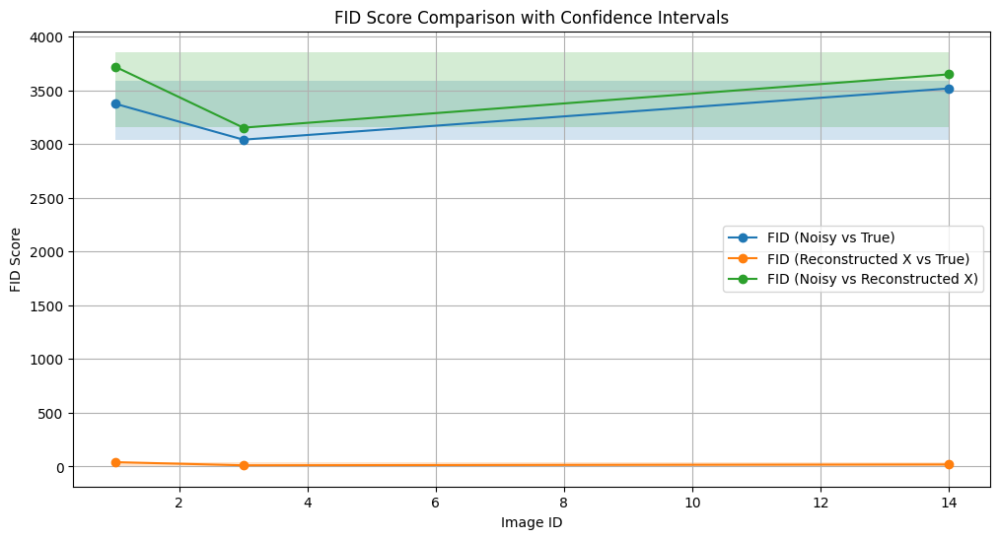

In [24]:
import numpy as np
import torch
import torchvision
import pandas as pd
from scipy.linalg import sqrtm
from PIL import Image
import matplotlib.pyplot as plt
from tabulate import tabulate
from scipy.stats import sem  # Standart hata hesaplamak için

# Görüntüyü tensor'dan numpy dizisine çevirme ve Inception uyumlu hale getirme
def tensor_to_numpy(img_tensor):
    img_tensor = img_tensor.squeeze(0).detach().cpu()  # (1,3,H,W) -> (3,H,W)
    img_numpy = img_tensor.permute(1, 2, 0).numpy()  # (H,W,3) olarak düzenle
    img_numpy = (img_numpy + 1) / 2  # [-1,1] -> [0,1] normalizasyonu geri alma
    img_numpy = np.clip(img_numpy * 255.0, 0, 255).astype(np.uint8)  # [0,255] aralığına getir
    return img_numpy

# FID hesaplama fonksiyonu
def calculate_fid(img1_tensor, img2_tensor):
    """İki PyTorch tensörü arasındaki FID skorunu hesaplar."""

    # Tensörleri numpy formatına çevir
    img1 = tensor_to_numpy(img1_tensor).reshape(-1, 3)
    img2 = tensor_to_numpy(img2_tensor).reshape(-1, 3)

    # Ortalama ve kovaryans hesapla
    mu1, sigma1 = np.mean(img1, axis=0), np.cov(img1, rowvar=False)
    mu2, sigma2 = np.mean(img2, axis=0), np.cov(img2, rowvar=False)

    # Frechet mesafesi hesapla
    ssdiff = np.sum((mu1 - mu2) ** 2.0)
    covmean = sqrtm(sigma1 @ sigma2)  # Kovaryans matrislerinin çarpımının karekökü
    if np.iscomplexobj(covmean):
        covmean = covmean.real  # Eğer karmaşık değer çıkarsa sadece reel kısmı al

    fid_score = ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid_score

# Örnek indeksler
indices = [1, 3, 14]

# FID sonuçlarını saklamak için listeler
fid_noisy_true_list = []
fid_recx_true_list = []
fid_noisy_recx_list = []
fid_results = []
for idx in indices:
    # Görüntüleri yükle ve tensöre çevir
    x_true_pil = Image.open(f'ffhq256-1k-validation/{str(idx).zfill(5)}.png')
    x_true = pilimg_to_tensor(x_true_pil)  # Orijinal görüntüyü tensöre çevir

    sigma_noise = 2 * 60 / 255
    y = linear_operator(x_true.clone()) + sigma_noise * torch.randn_like(x_true)  # Gürültülü görüntü

    # DPS ile rekonstrüksiyon al
    rec_x = ddpm.posterior_sampling(linear_operator, y, x_true=x_true, show_steps=True)

    # FID hesaplamaları
    fid_noisy_true = calculate_fid(x_true, y)
    fid_recx_true = calculate_fid(x_true, rec_x)
    fid_noisy_recx = calculate_fid(y, rec_x)

    # Sonuçları sakla
    fid_noisy_true_list.append(fid_noisy_true)
    fid_recx_true_list.append(fid_recx_true)
    fid_noisy_recx_list.append(fid_noisy_recx)

    fid_results.append([idx, fid_noisy_true, fid_recx_true, fid_noisy_recx])


fid_df = pd.DataFrame(fid_results, columns=[
    "Image ID",
    "FID (Noisy vs True)",
    "FID (Reconstructed X vs True)",
    "FID (Noisy vs Reconstructed X)"
])


# Ortalama ve güven aralıklarını hesapla
def confidence_interval(data):
    mean = np.mean(data)
    std = np.std(data)
    ci_low = mean - 1.96 * (std / np.sqrt(len(data)))
    ci_high = mean + 1.96 * (std / np.sqrt(len(data)))
    return mean, (ci_low, ci_high)

# Confidence interval hesaplamaları
fid_noisy_true_mean, fid_noisy_true_ci = confidence_interval(fid_noisy_true_list)
fid_recx_true_mean, fid_recx_true_ci = confidence_interval(fid_recx_true_list)
fid_noisy_recx_mean, fid_noisy_recx_ci = confidence_interval(fid_noisy_recx_list)

def confidence_interval(data):
    mean = np.mean(data)
    error = 1.96 * sem(data)  # 95% güven aralığı
    return mean, mean - error, mean + error

# ✅ 6. Confidence Interval hesapla
confidence_intervals = {}
for col in fid_df.columns[1:]:  # "Image ID" hariç tüm kolonlar için
    mean, lower, upper = confidence_interval(fid_df[col])
    confidence_intervals[col] = [mean, lower, upper]

confidence_df = pd.DataFrame(confidence_intervals, index=["Mean", "Lower CI", "Upper CI"])

print("\n📊 **FID Sonuçları** 📊")
print(tabulate(fid_df, headers="keys", tablefmt="fancy_grid"))
print("\n📌 **Confidence Intervals (95%)**")
print(tabulate(confidence_df, headers="keys", tablefmt="fancy_grid"))

# ✅ 8. Sonuçları görselleştirme (Chart oluşturma)
plt.figure(figsize=(12, 6))
for col in fid_df.columns[1:]:
    mean, lower, upper = confidence_interval(fid_df[col])
    plt.plot(fid_df["Image ID"], fid_df[col], marker='o', label=col)
    plt.fill_between(fid_df["Image ID"], lower, upper, alpha=0.2)  # Güven aralığını çiz

plt.xlabel("Image ID")
plt.ylabel("FID Score")
plt.title("FID Score Comparison with Confidence Intervals")
plt.legend()
plt.grid(True)
plt.show()